### Testing DeepLabV3+ Model on Large Satellite Imagery

In [1]:
from tensorflow import keras
model = keras.models.load_model('../models/deeplabv3.h5')

2023-01-17 16:41:53.854004: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-17 16:41:54.143510: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-17 16:41:54.192988: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-01-17 16:41:54.193006: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore 

In [2]:
import numpy as np
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt

In [3]:
def predict(image_array):
    image = tf.cast(image_array, tf.float32) / 255.0
    predictions = model.predict(np.expand_dims((image), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    pred_mask = predictions
    pred_mask = pred_mask.reshape(256,256,1)
    plt.imshow(tf.keras.preprocessing.image.array_to_img(pred_mask))
    plt.show()


In [4]:
from osgeo import gdal
import numpy as np
ds = gdal.Open("../data/RVCE_satellite_image.tif")
channel1 = np.array(ds.GetRasterBand(1).ReadAsArray())
channel2 = np.array(ds.GetRasterBand(2).ReadAsArray())
channel3 = np.array(ds.GetRasterBand(3).ReadAsArray())

image = np.dstack((channel1, channel2, channel3))


ERROR 1: libarrow.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libarrow.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libpodofo.so.0.9.8: cannot open shared object file: No such file or directory
ERROR 1: libpodofo.so.0.9.8: cannot open shared object file: No such file or directory
ERROR 1: libarrow_dataset.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libarrow_dataset.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libnetcdf.so.19: cannot open shared object file: No such file or directory
ERROR 1: libnetcdf.so.19: cannot open shared object file: No such file or directory
ERROR 1: libarrow.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libarrow.so.1000: cannot open shared object file: No such file or directory
ERROR 1: libpodofo.so.0.9.8: cannot open shared object file: No such file or directory
ERROR 1: libpodofo.so.0.9.8: cannot open shar

In [5]:
image.shape

(32812, 44033, 3)

In [6]:
## a function to compress the image into a lower resolution

def compress_image(image, scale):
    return cv2.resize(image, (0,0), fx=scale, fy=scale)

compressed_image = compress_image(image, 0.009)

In [7]:
image.shape

(32812, 44033, 3)

In [8]:
compressed_image.shape

(295, 396, 3)

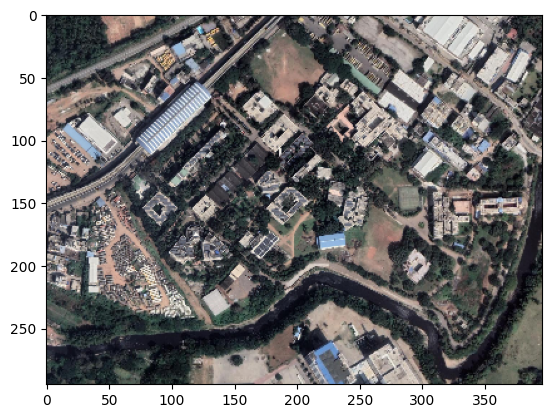

In [9]:
plt.imshow(compressed_image)

In [10]:
## split the image into 256x256 patches

def split_image(image, patch_size):
    patches = []
    for i in range(0, image.shape[0], patch_size):
        for j in range(0, image.shape[1], patch_size):
            patches.append(image[i:i+patch_size, j:j+patch_size, :])
    return patches

patches = split_image(compressed_image, 256)

In [43]:
compressed_image = compress_image(image, 0.056)
patches = split_image(compressed_image, 256)

In [44]:
compressed_image.shape

(1837, 2466, 3)

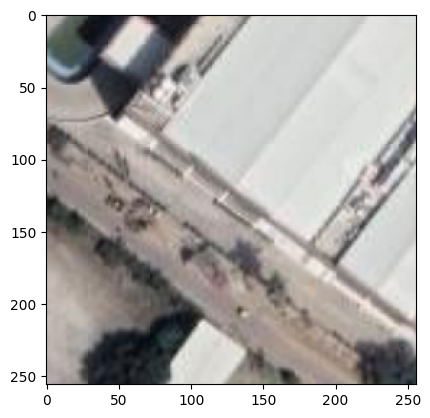

In [45]:
plt.imshow(patches[7])

In [46]:
len(patches)

80

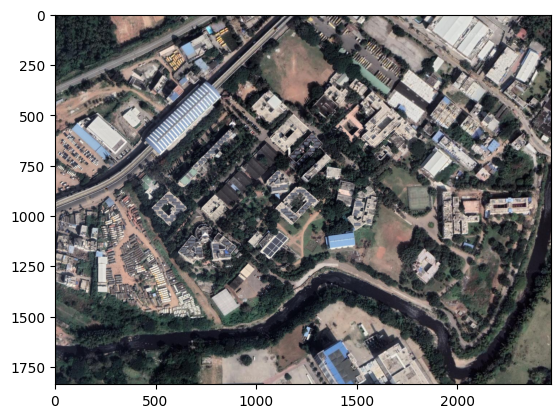

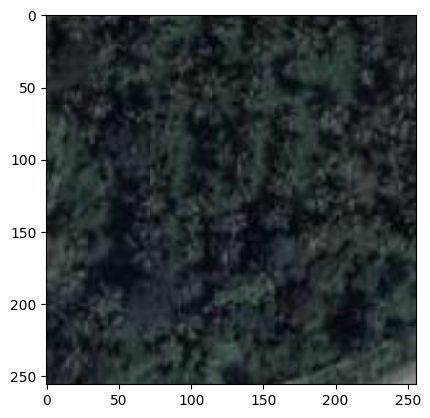

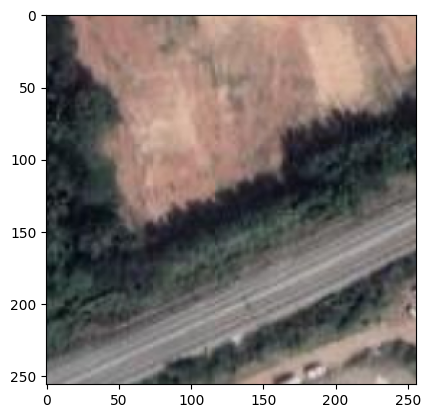

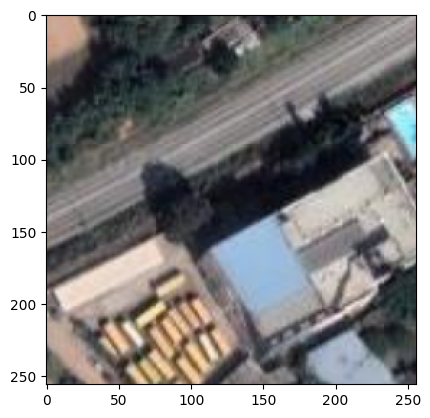

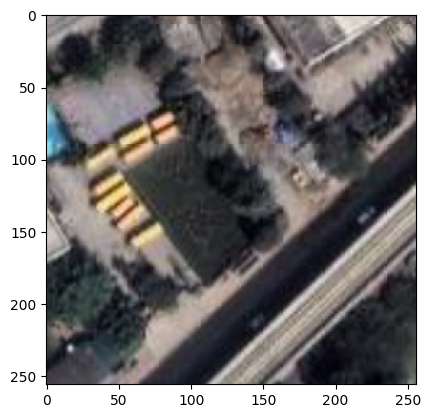

...

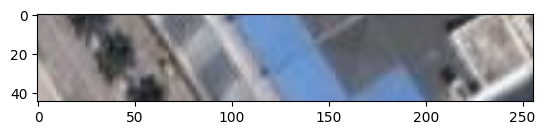

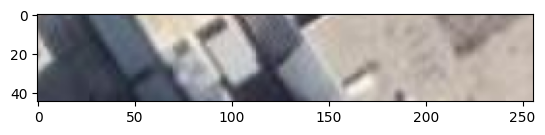

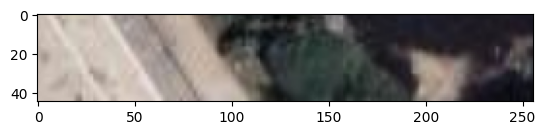

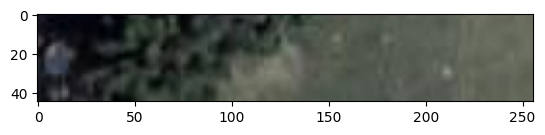

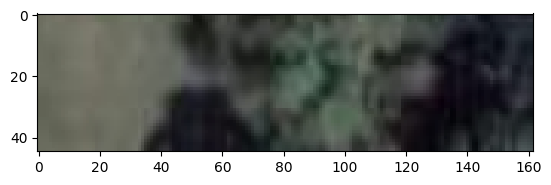

In [47]:
## Visualsing the chunks of the image with respect to the original image

plt.imshow(compressed_image)
plt.show()

for i in range(0, len(patches)):
    plt.imshow(patches[i])
    plt.show()


In [48]:
from PIL import Image

In [49]:
def predict(image_array, id):
    image = tf.cast(image_array, tf.float32) / 255.0
    predictions = model.predict(np.expand_dims((image), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    pred_mask = predictions
    pred_mask = pred_mask.reshape(256,256,1)
    ## plt.imshow(tf.keras.preprocessing.image.array_to_img(pred_mask))
    ## save the array as image
    return pred_mask



In [50]:
images = []
pred_masks = []

for i in range(0, len(patches)):
    if patches[i].shape == (256, 256, 3):
        images.append(patches[i])
        pred_masks.append(predict(patches[i], i))



1/1 [==============================] - 0s 146ms/step


In [52]:
def display(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image','Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

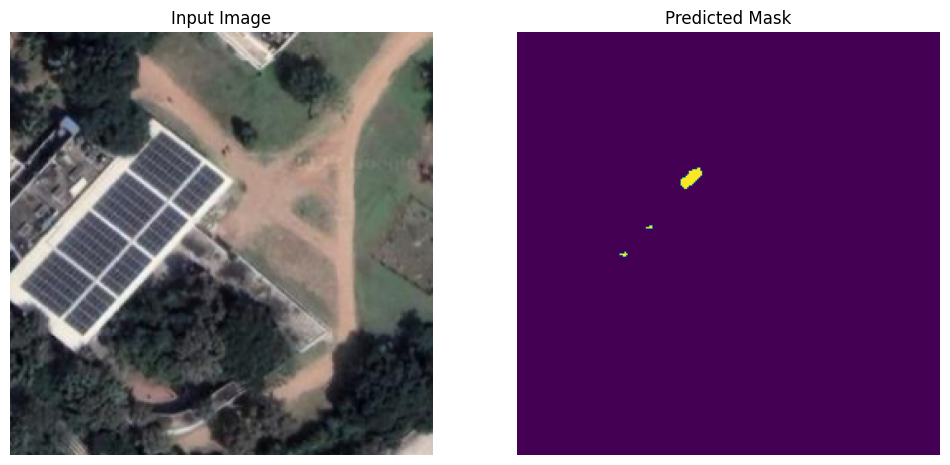

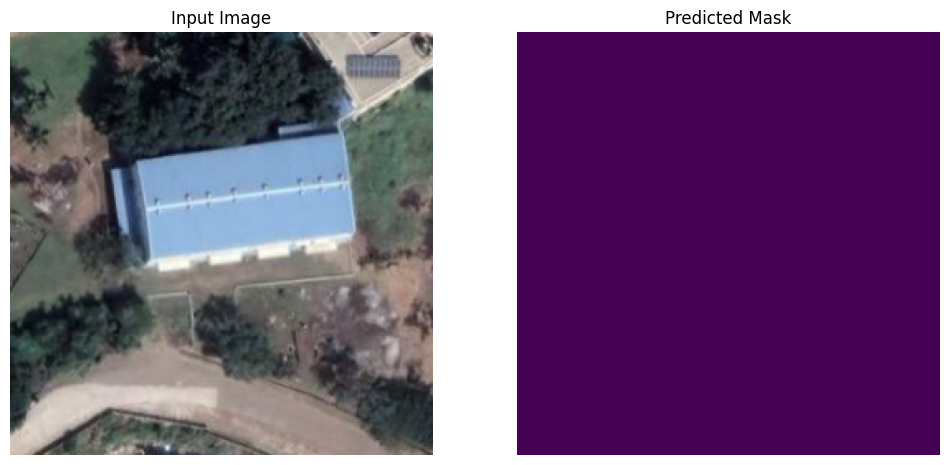

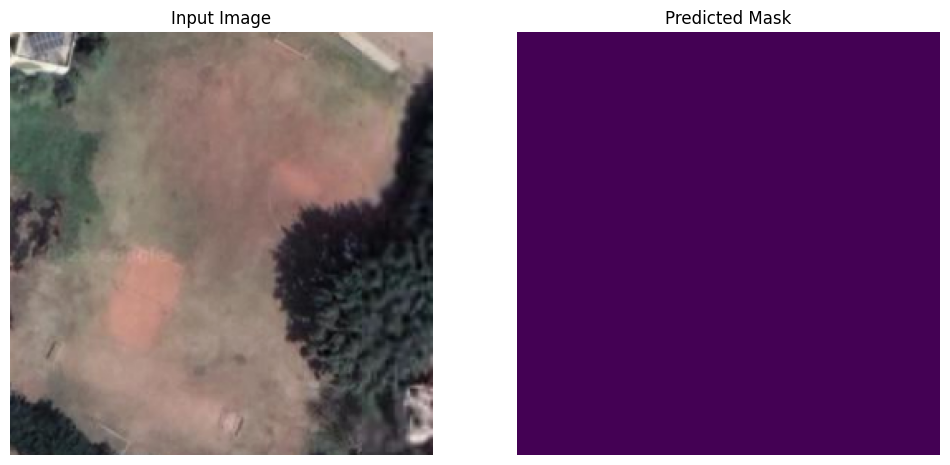

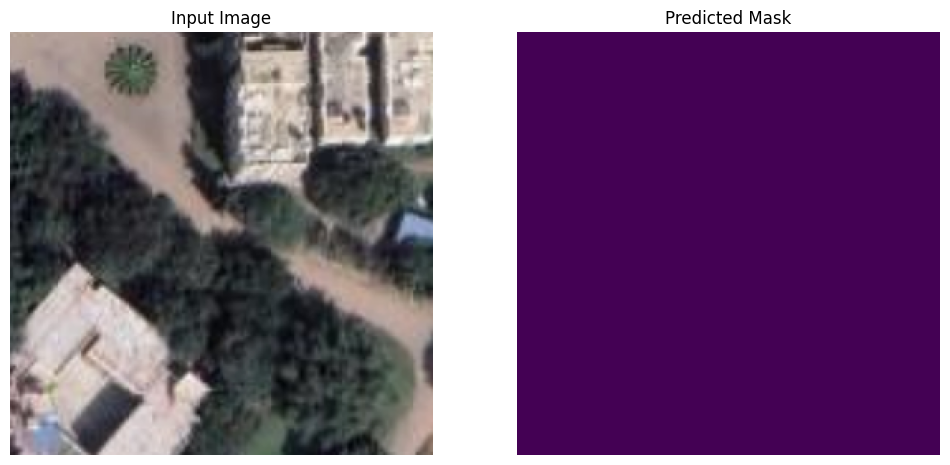

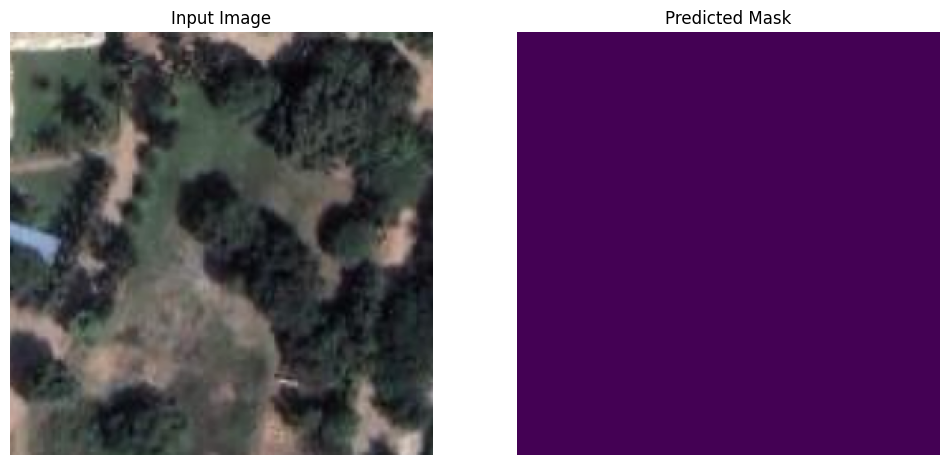

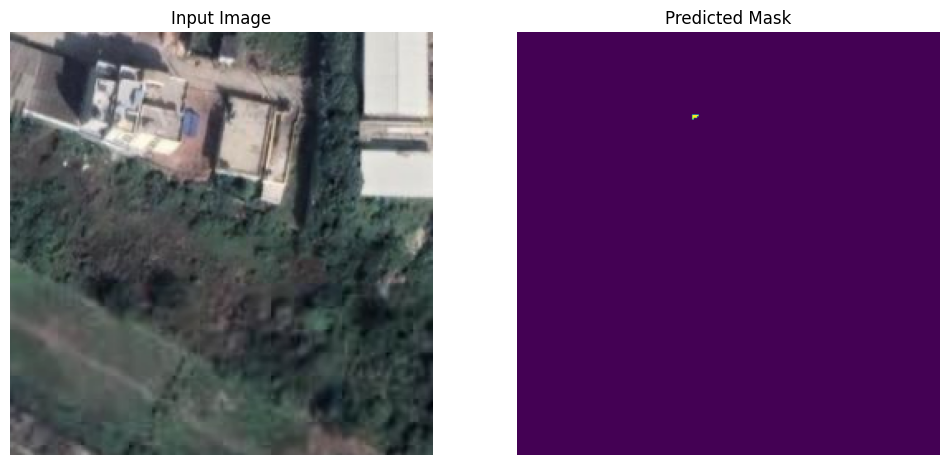

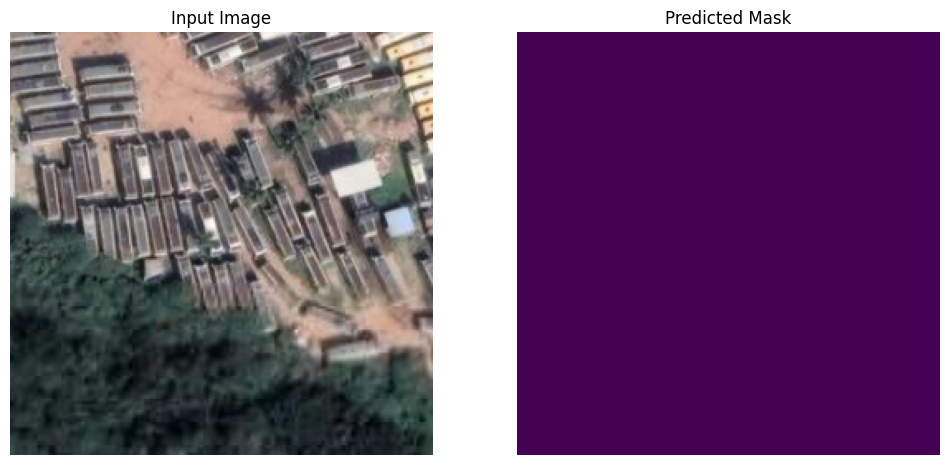

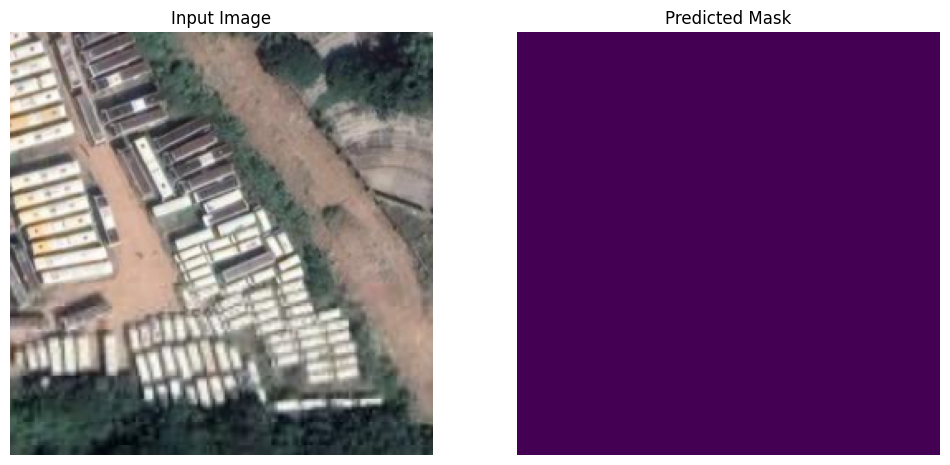

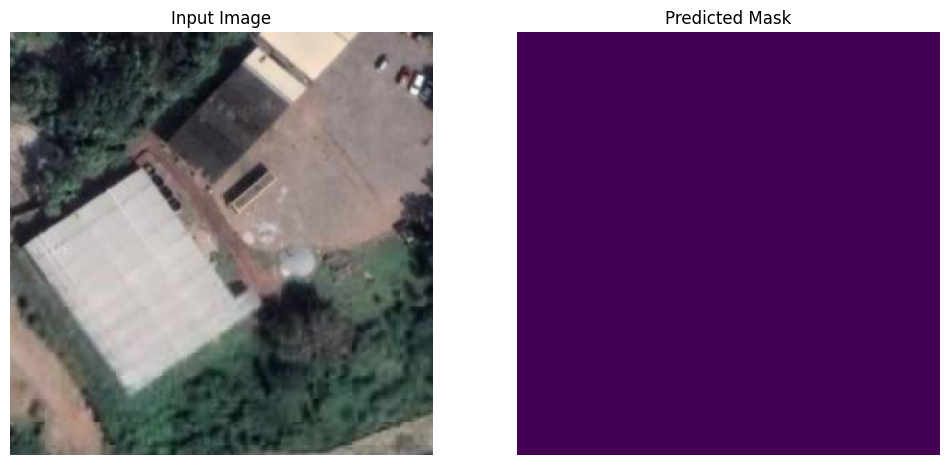

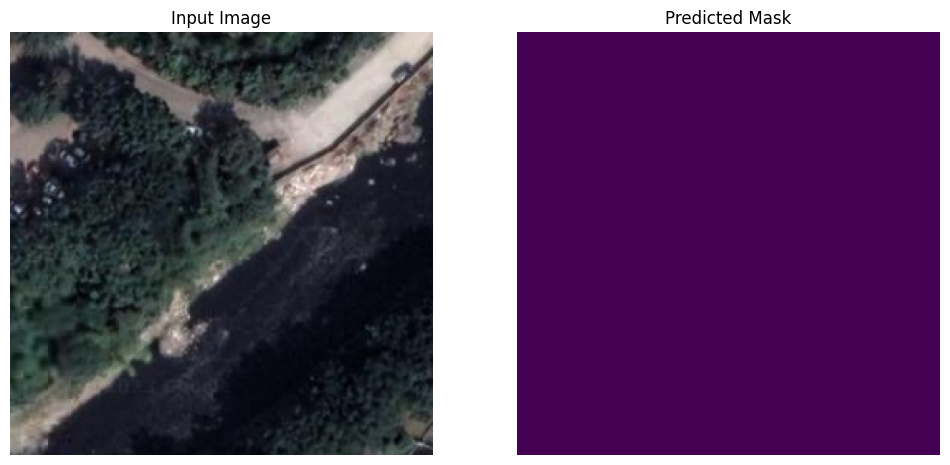

In [56]:
for i in range(40,50): display([images[i], pred_masks[i]])